# Education and Career Success
The following project seeks to utilize a [dataset](https://www.kaggle.com/datasets/adilshamim8/education-and-career-success) from Kaggle to conduct a data science inquiry on how education and career success may be aligned or related. We are personally vested in this project due to our graduating statuses nearing, which guides us to learning what the most important aspects of a good candidate for a successful career would be. Our personal stakes in this project ensure a devotion to getting accurate and clear answers to our questions, which then allows us to draw meaningful conclusions at the end of this project. Knowing the answers to our questions will help us understand how the job world works, what the profiles of successful people look like, and what thriving in a career post-education would look like.

## Research Questions
1. Are there patterns in certain fields of study in regard to gender? Is it fair to say that specific genders tend to lean towards a specific career path?
2. How do the fields of study affect career success and is it more important than other factors such as internships, projects, or networking?
3. Is it possible to predict career success for a student based on certain factors in their college education?
4. Is there an ideal machine learning algorithm to accurately model/predict certain patterns or results based on the entries found in the dataset? If so, what is the algorithm and why is it the best?

## Answers to Research Questions
1. HI
2. HI
3. HI
4. HI

## Challenge Goals

We will work towards two challenge goals throughout the duration of this project:
1. __Advanced Machine Learning:__ Use 3 different ML algorithms in scikit-learn with hyperparameter tuning
2. __New Library:__ Use `altair` to create interactive data visualizations

## Collaboration and Conduct

Students are expected to follow Washington state law on the [Student Conduct Code for the University of Washington](https://www.washington.edu/admin/rules/policies/WAC/478-121TOC.html). In this course, students must:

- Indicate on your submission any assistance received, including materials distributed in this course.
- Not receive, generate, or otherwise acquire any substantial portion or walkthrough to an assessment.
- Not aid, assist, attempt, or tolerate prohibited academic conduct in others.

Update the following code cell to include your name and list your sources. If you used any kind of computer technology to help prepare your assessment submission, include the queries and/or prompts. Submitted work that is not consistent with sources may be subject to the student conduct process.

In [1]:
your_name = "Alan Lin, Altti Koskinen"
sources = [
    "Education Assessment Notebook", "Mapping Assessment Notebook",
    "Google search query: 'seaborn documentation'", "https://seaborn.pydata.org/generated/seaborn.catplot.html",
    "Google search query: 'seaborn wide form data'", "https://seaborn.pydata.org/tutorial/data_structure.html",
    "Google search query: 'altair documentation'", "https://altair-viz.github.io",
    "https://altair-viz.github.io/gallery/bar_chart_sorted.html", "Primer Assessment Notebook",
    "Google search query: 'python series remove column'", "https://pandas.pydata.org/docs/reference/api/pandas.Series.drop.html",
    "Google search query: 'Change values of string to numbers in DataFrame'", 
    "https://saturncloud.io/blog/how-to-replace-strings-with-numbers-in-python-pandas-dataframe/",
    "Google search query: 'scikitlearn'", "https://scikit-learn.org/stable/user_guide.html"
]

assert your_name != "", "your_name cannot be empty"
assert ... not in sources, "sources should not include the placeholder ellipsis"
assert len(sources) >= 6, "must include at least 6 sources, inclusive of lectures and sections"

## Data Setting and Methods

We begin by importing our necessary dependencies for this project, including the interactive visualization library `altair`.

In [2]:
import doctest

import altair as alt
from altair import datum

import pandas as pd
import numpy as np

from matplotlib.collections import PatchCollection
from matplotlib.axes import Axes
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score

We then import the dataset as a Pandas DataFrame and set `Student_ID` as the index column since it is a unique identifier for each student within the DataFrame.

In [3]:
data = pd.read_csv("education_career_success.csv", na_values=["---"]).set_index("Student_ID")
data

,Age,Gender,High_School_GPA,SAT_Score,University_Ranking,University_GPA,Field_of_Study,Internships_Completed,Projects_Completed,Certifications,Soft_Skills_Score,Networking_Score,Job_Offers,Starting_Salary,Career_Satisfaction,Years_to_Promotion,Current_Job_Level,Work_Life_Balance,Entrepreneurship
Student_ID,,,,,,,,,,,,,,,,,,,
S00001,24,Male,3.58,1052,291,3.96,Arts,3,7,2,9,8,5,27200.0,4,5,Entry,7,No
S00002,21,Other,2.52,1211,112,3.63,Law,4,7,3,8,1,4,25000.0,1,1,Mid,7,No
S00003,28,Female,3.42,1193,715,2.63,Medicine,4,8,1,1,9,0,42400.0,9,3,Entry,7,No
S00004,25,Male,2.43,1497,170,2.81,Computer Science,3,9,1,10,6,1,57400.0,7,5,Mid,5,No
S00005,22,Male,2.08,1012,599,2.48,Engineering,4,6,4,10,9,4,47600.0,9,5,Entry,2,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S04996,26,Female,2.44,1258,776,2.44,Arts,3,7,3,8,5,5,31500.0,9,5,Mid,7,No
S04997,18,Female,3.94,1032,923,3.73,Law,0,9,3,6,4,5,41800.0,9,2,Entry,4,No
S04998,19,Female,3.45,1299,720,2.52,Law,3,5,5,6,2,2,49500.0,2,5,Mid,6,No


We can also create a subset of the DataFrame by making a duplicate of the first ten entries in `data` and assigning that to our variable `mini`, which will function as our testing dataset for this project.

In [4]:
mini = data.head(10)
mini

,Age,Gender,High_School_GPA,SAT_Score,University_Ranking,University_GPA,Field_of_Study,Internships_Completed,Projects_Completed,Certifications,Soft_Skills_Score,Networking_Score,Job_Offers,Starting_Salary,Career_Satisfaction,Years_to_Promotion,Current_Job_Level,Work_Life_Balance,Entrepreneurship
Student_ID,,,,,,,,,,,,,,,,,,,
S00001,24,Male,3.58,1052,291,3.96,Arts,3,7,2,9,8,5,27200.0,4,5,Entry,7,No
S00002,21,Other,2.52,1211,112,3.63,Law,4,7,3,8,1,4,25000.0,1,1,Mid,7,No
S00003,28,Female,3.42,1193,715,2.63,Medicine,4,8,1,1,9,0,42400.0,9,3,Entry,7,No
S00004,25,Male,2.43,1497,170,2.81,Computer Science,3,9,1,10,6,1,57400.0,7,5,Mid,5,No
S00005,22,Male,2.08,1012,599,2.48,Engineering,4,6,4,10,9,4,47600.0,9,5,Entry,2,No
S00006,24,Male,2.40,1600,631,3.78,Law,2,3,2,2,2,1,68400.0,9,2,Entry,8,Yes
S00007,27,Male,2.36,1011,610,3.83,Computer Science,0,1,3,3,3,2,55500.0,7,4,Mid,3,No
S00008,20,Male,2.68,1074,240,2.84,Computer Science,1,5,5,5,1,2,38000.0,2,3,Entry,3,No
S00009,24,Male,2.84,1201,337,3.31,Business,2,3,0,5,5,2,68900.0,2,2,Entry,2,No


We now check if there exist any Null values in the dataset, as well as the number of unique values for each column in the DataFrame.

In [5]:
na_counts = data.isna().sum()
print(na_counts)

Age                      0
Gender                   0
High_School_GPA          0
SAT_Score                0
University_Ranking       0
University_GPA           0
Field_of_Study           0
Internships_Completed    0
Projects_Completed       0
Certifications           0
Soft_Skills_Score        0
Networking_Score         0
Job_Offers               0
Starting_Salary          0
Career_Satisfaction      0
Years_to_Promotion       0
Current_Job_Level        0
Work_Life_Balance        0
Entrepreneurship         0
dtype: int64


In [6]:
unique_vals = data.nunique()
print(unique_vals)

Age                       12
Gender                     3
High_School_GPA          201
SAT_Score                700
University_Ranking       993
University_GPA           201
Field_of_Study             7
Internships_Completed      5
Projects_Completed        10
Certifications             6
Soft_Skills_Score         10
Networking_Score          10
Job_Offers                 6
Starting_Salary          623
Career_Satisfaction       10
Years_to_Promotion         5
Current_Job_Level          4
Work_Life_Balance         10
Entrepreneurship           2
dtype: int64


We see that the dataset contains no Null values, and there are many different values that exist in certain columns (like `University_Ranking` and `Starting_Salary`), some columns use integer values between 1-10 to quantify values (such as `Career_Satisfation` and `Soft_Skills_Score`), while others simply have binary or a handful of values to choose from (such as `Gender` and `Entrepreneurship`). This distribution of the DataFrame will inform our choices as we move forward in this project.

## Results

*Replace this text with your results. This section tends to be one of the longer sections of the notebook. Be sure to create new code cells and new Markdown text cells with additional subheadings to explain and break-up longer snippets of code into a more readable format.*

1. *Present and discuss your research results. Treat each of your research questions separately. Include additional discussions for results that are most interesting, surprising, or important.*
2. *Interpret the results. If the answers are unexpected, try to offer an explanation. A good report not only presents the results, but also provides an argument or interpretation based on the data analysis.*
3. *Include any visualizations you have made. In general, these should be generated by your Python code. If you plotted by hand or other software, explain why it was not possible to create the plot you wanted in Python and what you tried.*

*As with assessments, documentation and testing are required. Automated tests must be written in Python using small, manually-verifiable data.*

### EDA with `altair`
Our following steps will involve some exploratory data analysis, where we will utilize the `altair` library in order to create interactive visualizations that may show some relationships between certain columns in the dataset while also meeting our second challenge goal. Each of the subsequently generated plots will be labeled for ease of readability.

The first visualization we create will help us answer our first research question by allowing the user to filter the dataset by gender and analyze the distribution in field of study for students of these various genders.

In [7]:
input_dropdown = alt.binding_select(options=['Male', 'Female', 'Other'], name='Gender: ')
selection = alt.selection_point(fields=['Gender'], bind=input_dropdown, value = "Male")
title = "Number of Students Studying Each Field for Selected Gender"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Field_of_Study").title("Field of Study"),
    alt.Y("count()").title("Number of Students"),
    alt.Color(field = "Entrepreneurship"),
    tooltip = [alt.Tooltip(field = "Gender", title = "Gender:"),
               alt.Tooltip(field = "Field_of_Study", title = "Field of Study:"),
               alt.Tooltip(aggregate = "count", title = "Count:"),
               alt.Tooltip(field = "Entrepreneurship", title = "Entrepreneurship:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

The visualization above allows us to form an answer to the first research question. We see that the data seems to be similar to a uniform distribution for all genders, and there is no significant inclination to a specific field regardless of gender. On top of that, entrepreneurship seems to be uniformly distributed across the various fields of study as well for all genders in this dataset, which suggests that gender and field of study do not have a significant (if even noticeable) effect on students choosing to start a personal business upon graduation. An interesting thing to note is that Computer Science was the least-pursued field of study for males and females in this dataset, but the most popular field of study for students in this dataset who identified their gender as other. Another interesting conclusion from this visualization is that the most pursued field of study for males were the arts, whereas the most pursued field of study for females was Law. Overall, this interactive visualization provides a significant amount of information regarding the distribution of fields of study based on gender and entrepreneurship, but doesn't allow us to find any conclusive perspectives with regards to patterns in this dataset with the corresponding columns.

We next look to map the performances of students in high school and university settings by creating a scatter plot that sets their GPAs in both educational levels. We also created a scatter plot that maps the quantitative measurables for a high school student (their GPA and SAT score), which are keystone indicators of student performance in university admission deisions. 

In [8]:
title = "University vs High School GPA"
alt.Chart(data, title = title, width = 500, height = 500).mark_circle().encode(
    alt.X("High_School_GPA").title("High School GPA"), 
    alt.Y("University_GPA").title("University GPA"),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "High_School_GPA", title = "High School GPA:"),
             alt.Tooltip(field = "University_GPA", title = "University GPA:")]
    ).interactive()

alt.Chart(...)

In [9]:
title = "SAT Score vs High School GPA"
alt.Chart(data, title = title, width = 500, height = 500).mark_circle().encode(
    alt.X("High_School_GPA").title("High School GPA"), 
    alt.Y("SAT_Score").title("SAT Score"),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "High_School_GPA", title = "High School GPA:"),
               alt.Tooltip(field = "SAT_Score", title = "SAT Score:")]
    ).interactive()

alt.Chart(...)

We then pivot to answering the second of our research questions. We note that the second question asks us to compare the relationship between fields of study for students and career success with other factors such as internships, projects, and networking. To solve this, we first need to create a definition for "career success". Among the 20 columns in the dataset, the best ones for measuring career success are: `Job_Offers`, `Starting_Salary`, `Career_Satisfaction`, `Years_to_Promotion`, `Current_Job_Level`, and `Work_Life_Balance`. As such, we attempt to create a visualization that can accurately capture the effects of fields of study, internships, projects, networking scores, and such on the 6 columns mentioned above. To do so, we can create various interactive visualizations that each capture a column from above and utilize one of the factors we mentioned. 

We start by looking at the effect that field of study has on a student's options out of college.

In [10]:
num_jobs = sorted(list(set(data["Job_Offers"].values)))
print(num_jobs)

[0, 1, 2, 3, 4, 5]


In [11]:
input_dropdown = alt.binding_select(options = num_jobs, name = 'Number of Job Offers Out of University: ')
selection = alt.selection_point(fields=['Job_Offers'], bind=input_dropdown, value = 0)
title = "Selected Number of Job Offers for Various Fields of Study"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Field_of_Study").title("Field of Study"),
    alt.Y("count()").title("Count").scale(domain = [0, 160]),
    tooltip = [alt.Tooltip(field = "Field_of_Study", title = "Field of Study:"),
                alt.Tooltip(aggregate = "count", title = "Number of Job Offers:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

In [12]:
majors = sorted(list(set(data["Field_of_Study"].values)))
print(majors)

['Arts', 'Business', 'Computer Science', 'Engineering', 'Law', 'Mathematics', 'Medicine']


In [13]:
input_dropdown = alt.binding_select(options = majors, name = 'Field of Study: ')
selection = alt.selection_point(fields=["Field_of_Study"], bind=input_dropdown)
title = "Histogram of Starting Salary Based on Selected Field of Study"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Starting_Salary:Q", bin = True).title("Starting Salary"),
    alt.Y("count()").title("Count"),
    tooltip = [alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

Our dataset is open to many types of questions with regards to career success and the educational backgrounds of the students with such success cases. One angle we thought of exploring was analyzing the effects of various educational factors on the number of years it takes for a worker to get a promotion.

In [14]:
promotion_time = sorted(list(set(data["Years_to_Promotion"].values)))
print(promotion_time)

[1, 2, 3, 4, 5]


In [15]:
input_dropdown = alt.binding_select(options = promotion_time, name = 'Years to Job Promotion: ')
selection = alt.selection_point(fields=['Years_to_Promotion'], bind=input_dropdown, value = 1)

title1 = "Count of Selected Years to Promotion Based on University Ranking (Binned)"
chart1 = alt.Chart(data, title = title1, width = 450).mark_bar().encode(
    alt.X("University_Ranking:Q", bin = True).title("University Ranking"),
    alt.Y("count()").title("Count").scale(domain = [0, 180]),
    tooltip = [alt.Tooltip(field = "University_Ranking:Q", title = "University Ranking:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title2 = "Count of Selected Years to Promotion Based on University GPA (Binned)"
chart2 = alt.Chart(data, title = title2, width = 450).mark_bar().encode(
    alt.X("University_GPA:Q", bin = True).title("University GPA"),
    alt.Y("count()").title("Count").scale(domain = [0, 140]),
    tooltip = [alt.Tooltip(field = "University_GPA:Q", title = "University GPA:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title3 = "Count of Selected Years to Promotion Based on Field of Study"
chart3 = alt.Chart(data, title = title3, width = 450).mark_bar().encode(
    alt.X("Field_of_Study").title("Field of Study"),
    alt.Y("count()").title("Count").scale(domain = [0, 180]),
    tooltip = [alt.Tooltip(field = "Field_of_Study", title = "Field of Study:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title4 = "Count of Selected Years to Promotion Based on Number of Internships Completed"
chart4 = alt.Chart(data, title = title4, width = 450).mark_bar().encode(
    alt.X("Internships_Completed:O").title("Internships Completed"),
    alt.Y("count()").title("Number of Internships Completed").scale(domain = [0, 240]),
    tooltip = [alt.Tooltip(field = "Internships_Completed", title = "Internships Completed:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title5 = "Count of Selected Years to Promotion Based on Number of Projects Completed"
chart5 = alt.Chart(data, title = title5, width = 450).mark_bar().encode(
    alt.X("Projects_Completed:O").title("Projects Completed"),
    alt.Y("count()").title("Number of Projects Completed").scale(domain = [0, 120]),
    tooltip = [alt.Tooltip(field = "Projects_Completed", title = "Projects Completed:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title6 = "Count of Selected Years to Promotion Based on Number of Certifications"
chart6 = alt.Chart(data, title = title6, width = 450).mark_bar().encode(
    alt.X("Certifications:O").title("Certifications"),
    alt.Y("count()").title("Number of Certifications").scale(domain = [0, 200]),
    tooltip = [alt.Tooltip(field = "Certifications", title = "Number of Certifications:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title7 = "Count of Selected Years to Promotion Based on Soft Skills Score"
chart7 = alt.Chart(data, title = title7, width = 450).mark_bar().encode(
    alt.X("Soft_Skills_Score:O").title("Soft Skills Score"),
    alt.Y("count()").title("Count").scale(domain = [0, 120]),
    tooltip = [alt.Tooltip(field = "Soft_Skills_Score", title = "Soft Skills Score:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title8 = "Count of Selected Years to Promotion Based on Networking Score"
chart8 = alt.Chart(data, title = title8, width = 450).mark_bar().encode(
    alt.X("Networking_Score:O").title("Networking Score"),
    alt.Y("count()").title("Count").scale(domain = [0, 120]),
    tooltip = [alt.Tooltip(field = "Networking_Score", title = "Networking Score:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

alt.vconcat(alt.hconcat(chart1, chart2), alt.hconcat(chart3, chart4), alt.hconcat(chart5, chart6), alt.hconcat(chart7, chart8))

alt.VConcatChart(...)

Overall, though, this dataset allows us to look into a myriad of complex relationships with regards to how educational background can translate to career success (or failure, as well)!

In [16]:
num_internships = sorted(list(set(data["Internships_Completed"].values)))
print(num_internships)

[0, 1, 2, 3, 4]


In [17]:
input_dropdown = alt.binding_select(options = num_internships, name = 'Internships Completed: ')
selection = alt.selection_point(fields=['Internships_Completed'], bind=input_dropdown, value = 0)
title = "Count of Current Job Level with Selected Number of Internships Completed"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Current_Job_Level").sort(["Entry", "Mid", "Senior", "Executive"]).title("Current Job Level"),
    alt.Y("count()").title("Count").scale(domain=[0, 550]),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "Current_Job_Level", title = "Current Job Level:"),
               alt.Tooltip(field = "Gender", title = "Gender:"),
              alt.Tooltip(aggregate = "count", title = "Count:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

In [18]:
input_dropdown = alt.binding_select(options = majors, name = 'Major: ')
selection = alt.selection_point(fields=['Field_of_Study'], bind=input_dropdown, value = "Arts")
title = "Count of Career Satisfaction with Selected Major"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Career_Satisfaction:O").title("Career Satisfaction"),
    alt.Y("count()").title("Number of Students"),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "Career_Satisfaction", title = "Career Satisfaction Level:"),
               alt.Tooltip(field = "Gender", title = "Gender:"),
              alt.Tooltip(aggregate = "count", title = "Count:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

In [19]:
input_dropdown = alt.binding_select(options = majors, name = 'Major: ')
selection = alt.selection_point(fields=['Field_of_Study'], bind=input_dropdown, value = "Arts")
title = "Count of Career Satisfaction with Selected Major"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Career_Satisfaction:O").title("Career Satisfaction"),
    alt.Y("count()").title("Number of Students"),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "Career_Satisfaction", title = "Career Satisfaction Level:"),
               alt.Tooltip(field = "Gender", title = "Gender:"),
              alt.Tooltip(aggregate = "count", title = "Count:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

### Reserve this and next two cells for Altti's additional visualization(s)

### CONCLUSIONS FROM DATA VISUALIZATIONS AND TRANSITION TO NEXT PART

HIHIHI

### About the data itself
We want the datatypes contained within our columns, so we run a command to capture that. This will then allow us to do data manipulation as necessary for computational steps like getting means and aggregate values, which are good benchmarks that we can use later on in this project.

In [20]:
col_types = data.dtypes
col_types

Age                        int64
Gender                    object
High_School_GPA          float64
SAT_Score                  int64
University_Ranking         int64
University_GPA           float64
Field_of_Study            object
Internships_Completed      int64
Projects_Completed         int64
Certifications             int64
Soft_Skills_Score          int64
Networking_Score           int64
Job_Offers                 int64
Starting_Salary          float64
Career_Satisfaction        int64
Years_to_Promotion         int64
Current_Job_Level         object
Work_Life_Balance          int64
Entrepreneurship          object
dtype: object

We next write a function that will allow us to take the average of specific columns of interest. To check our work, we can precompute the values of 3 columns from our testing dataset `mini`. We choose to calculate the average of the `Age`, `University_GPA`, `Starting_Salary` columns.

For the `Age` column, we have: $\frac{(24 + 21 + 28 + 25 + 22 + 24 + 27 + 20 + 24 + 28)}{10} = 24.3$ 

For the `University_GPA` column, we have: $\frac{(3.96 + 3.63 + 2.63 + 2.81 + 2.48 + 3.78 + 3.83 + 2.84 + 3.31 + 2.33)}{10} = 3.16$ 

For the `Starting_Salary` column, we have: $\frac{(27200.0 + 25000.0 + 42400.0 + 57400.0 + 47600.0 + 68400.0 + 55500.0 + 38000.0 + 68900.0 + 58900.0)}{10} = 48,930.0$

In [21]:
def avg_col(col, data):
    '''
    avg_col returns the mean value of the column that is passed in. It takes two parameters:
    col is a String with the name of the desired column (case-sensitive), and data (a DataFrame)
    with the information to look from
    >>> avg_col("Age", mini)
    Average of Age is: 24.3
    >>> avg_col("University_GPA", mini)
    Average of University_GPA is: 3.16
    >>> avg_col("Starting_Salary", mini)
    Average of Starting_Salary is: 48930.0
    '''
    print("Average of", col, "is:", data[col].mean())
    
doctest.run_docstring_examples(avg_col, globals())

Our next step is to drop the columns in `data` that have data type `Object` so that we can run our `col_avg()` function on the remaining columns and get the average of each column value.

In [22]:
object_cols = ["Gender", "Field_of_Study", "Current_Job_Level", "Entrepreneurship"]
numerical_col_types = col_types
numerical_cols = data.columns
for col in object_cols:
    numerical_col_types = numerical_col_types.drop(col)
    numerical_cols = numerical_cols.drop(col)
numerical_col_types

Age                        int64
High_School_GPA          float64
SAT_Score                  int64
University_Ranking         int64
University_GPA           float64
Internships_Completed      int64
Projects_Completed         int64
Certifications             int64
Soft_Skills_Score          int64
Networking_Score           int64
Job_Offers                 int64
Starting_Salary          float64
Career_Satisfaction        int64
Years_to_Promotion         int64
Work_Life_Balance          int64
dtype: object

Now that we have the `avg_col()` function written and have dropped the columns that aren't numerical, we can create an "average" student in this dataset by calling the function on the various numerical value columns. This gives us a sense of what a typical student would look like in this dataset.

In [23]:
for col in numerical_cols:
    avg_col(col, data)

Average of Age is: 23.4422
Average of High_School_GPA is: 2.9969780000000004
Average of SAT_Score is: 1253.832
Average of University_Ranking is: 504.3356
Average of University_GPA is: 3.0200280000000004
Average of Internships_Completed is: 1.9822
Average of Projects_Completed is: 4.5628
Average of Certifications is: 2.5122
Average of Soft_Skills_Score is: 5.546
Average of Networking_Score is: 5.538
Average of Job_Offers is: 2.4888
Average of Starting_Salary is: 50563.54
Average of Career_Satisfaction is: 5.578
Average of Years_to_Promotion is: 3.0158
Average of Work_Life_Balance is: 5.4824


### In a similar vein as above
We now create a method called `median_col()` that will return the median value of each numeric column. This allows us to compare our "average" stupid with another student who is in the middle of the pack based on the data presented in this datatset. We will test our method using our `mini` dataset once again, and we use the three columns `High_School_GPA`, `University_Ranking`, and `Internships_Completed` for the doctests in this method.

For the `High_School_GPA` column, the median is the average of the 5th and 6th ordered values: $\frac{(2.52+2.68)}{2} = 2.6$

For the `University_Ranking` column, the median is the average of the 5th and 6th ordered values: $\frac{(291+337)}{2} = 314.0$

For the `Internships_Completed` column, the median is the average of the 5th and 6th ordered values: $\frac{(2+3)}{2} = 2.5$

In [24]:
def median_col(col, data):
    '''
    median_col returns the median value of the column that is passed in. It takes two parameters:
    col is a String with the name of the desired column (case-sensitive), and data is a DataFrame
    with the information to look from
    >>> median_col("High_School_GPA", mini)
    Median of High_School_GPA is: 2.6
    >>> median_col("University_Ranking", mini)
    Median of University_Ranking is: 314.0
    >>> median_col("Internships_Completed", mini)
    Median of Internships_Completed is: 2.5
    '''

    print("Median of", col, "is:", data[col].median())

doctest.run_docstring_examples(median_col, globals())

In [25]:
for col in numerical_cols:
    median_col(col, data)

Median of Age is: 23.0
Median of High_School_GPA is: 2.99
Median of SAT_Score is: 1257.0
Median of University_Ranking is: 501.5
Median of University_GPA is: 3.03
Median of Internships_Completed is: 2.0
Median of Projects_Completed is: 5.0
Median of Certifications is: 3.0
Median of Soft_Skills_Score is: 6.0
Median of Networking_Score is: 6.0
Median of Job_Offers is: 2.0
Median of Starting_Salary is: 50300.0
Median of Career_Satisfaction is: 6.0
Median of Years_to_Promotion is: 3.0
Median of Work_Life_Balance is: 6.0


In [26]:
test_results = doctest.testmod()
print(test_results)
assert test_results.failed == 0, "There are failed doctests."
# assert test_results.attempted >= 25, "Total number of doctests should be at least 25; less than 25 means you did not add two additional test cases per task."

TestResults(failed=0, attempted=6)


## Next Steps: Machine Learning
We began this project by mainly utilizing the functionalities of the `altair` library to create many visualizations that could tell some stories about the dataset we are working with. Now that we have a brief overview of our dataset and a grasp of the datatypes contained within the columns, we are ready to move on to the machine learning implementations of our project. Our first step is to try doing single variable linear regression as an exercise by using our intuition to test what we believe would matter with regards to career success.

We also want to distinguish a point here for future reference: our definition of "career success" will come from a multitude of columns in the dataset, specifically: `Job_Offers`, `Starting_Salary`, `Career_Satisfaction`, `Years_to_Promotion`, `Current_Job_Level`, and `Work_Life_Balance`. These six columns will allow us to assess various aspects of success once a student graduates from their university, and we will quantify success itself by using the median values calculated above. That means success will be:

At least 2 `Job_Offers`.

At least 50300.0 `Starting_Salary`.

At least 6.0 `Career_Satisfaction`.

At most 3.0 `Years_to_Promotion`.

At least Mid level `Current_Job_Level`.

At least 6.0 `Work_Life_Balance`.

An important thing to note is that we can online apply linear regression to the `Starting_Salary` column, since that is the only column where we can have a range of values that can be predicted using another quantitative variable. Our other "career success" indicator columns are all categorical, which means we simply cannot run linear regression on them to get the results we desire.

In [27]:
def run_single_var_linear_regression(col_X, col_y):
    X = data[[col_X]]
    y = data[col_y]
    reg = LinearRegression().fit(X, y)

    print("Model:", " + ".join([f"{reg.intercept_:.2f}"] + [f"{coef:.2f}({X.columns[i]})" for i, coef in enumerate(reg.coef_)]))
    print("Error:", mean_squared_error(y, reg.predict(X)))
    
    plt.scatter(X, y)
    plt.plot(X, reg.predict(X), color = "orange")

Model: 50026.85 + 1.06(University_Ranking)
Error: 209965876.99221933


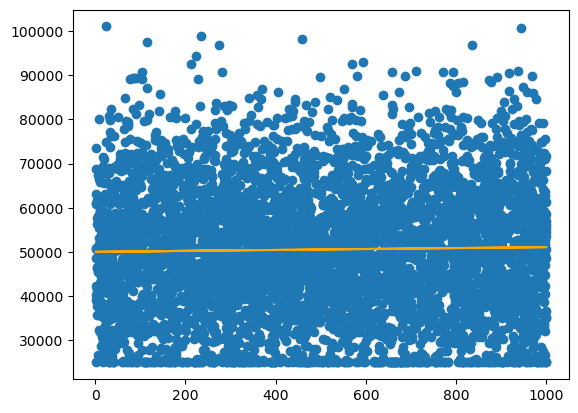

In [28]:
run_single_var_linear_regression("University_Ranking", "Starting_Salary")

Model: 50485.84 + 25.73(University_GPA)
Error: 210061573.0538188


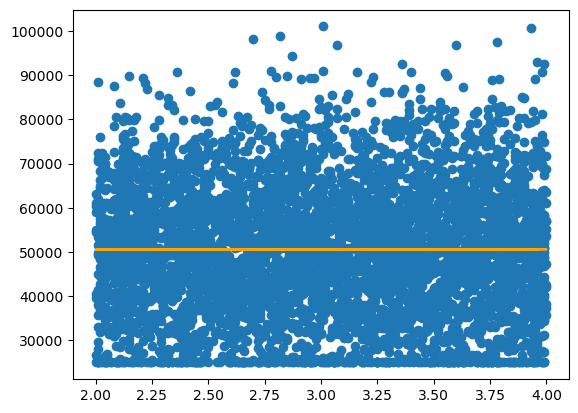

In [29]:
run_single_var_linear_regression("University_GPA", "Starting_Salary")

We note that using singular variables does not quite seem to operate as well as we want, and the graphs themselves suggest that single variable regression is not a useful means of prediction for this dataset. As such, we will venture into multi-variable linear regression to see if that helps us generate a better prediction model. As such, we need to create a copy of our dataset with dummy variables so that categorical variables are transformed into binaries that we can then run machine learning algorithms on.

In [4]:
ml_data = pd.get_dummies(data)
display(ml_data)

,Age,High_School_GPA,SAT_Score,University_Ranking,University_GPA,Internships_Completed,Projects_Completed,Certifications,Soft_Skills_Score,Networking_Score,...,Field_of_Study_Engineering,Field_of_Study_Law,Field_of_Study_Mathematics,Field_of_Study_Medicine,Current_Job_Level_Entry,Current_Job_Level_Executive,Current_Job_Level_Mid,Current_Job_Level_Senior,Entrepreneurship_No,Entrepreneurship_Yes
Student_ID,,,,,,,,,,,,,,,,,,,,,
S00001,24,3.58,1052,291,3.96,3,7,2,9,8,...,False,False,False,False,True,False,False,False,True,False
S00002,21,2.52,1211,112,3.63,4,7,3,8,1,...,False,True,False,False,False,False,True,False,True,False
S00003,28,3.42,1193,715,2.63,4,8,1,1,9,...,False,False,False,True,True,False,False,False,True,False
S00004,25,2.43,1497,170,2.81,3,9,1,10,6,...,False,False,False,False,False,False,True,False,True,False
S00005,22,2.08,1012,599,2.48,4,6,4,10,9,...,True,False,False,False,True,False,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S04996,26,2.44,1258,776,2.44,3,7,3,8,5,...,False,False,False,False,False,False,True,False,True,False
S04997,18,3.94,1032,923,3.73,0,9,3,6,4,...,False,True,False,False,True,False,False,False,True,False
S04998,19,3.45,1299,720,2.52,3,5,5,6,2,...,False,True,False,False,False,False,True,False,True,False


At this point, we see that our single-variable linear regression experiment seems quite naive and unrealistic, and so we move on to using multi-variable linear regression with the hopes that it will decrease our error and better explain our data. Our approach is to use all columns in the dataset except for `Starting_Salary` to predict the value of `Starting_Salary`. 

In [31]:
X = ml_data.drop("Starting_Salary", axis = 1)
y = ml_data["Starting_Salary"]
reg = LinearRegression().fit(X, y)

print("Model:", " + ".join([f"{reg.intercept_:.2f}"] + [f"{coef:.2f}({X.columns[i]})" for i, coef in enumerate(reg.coef_)]))
print("Error:", mean_squared_error(y, reg.predict(X)))

Model: 48684.09 + 50.03(Age) + -218.93(High_School_GPA) + 0.27(SAT_Score) + 1.11(University_Ranking) + 25.51(University_GPA) + 196.49(Internships_Completed) + 68.47(Projects_Completed) + -163.77(Certifications) + 16.21(Soft_Skills_Score) + 11.93(Networking_Score) + -291.77(Job_Offers) + 11.25(Career_Satisfaction) + 65.58(Years_to_Promotion) + 29.73(Work_Life_Balance) + 264.18(Gender_Female) + 345.19(Gender_Male) + -609.37(Gender_Other) + 856.60(Field_of_Study_Arts) + -330.12(Field_of_Study_Business) + 226.62(Field_of_Study_Computer Science) + -166.18(Field_of_Study_Engineering) + -474.28(Field_of_Study_Law) + 208.08(Field_of_Study_Mathematics) + -320.73(Field_of_Study_Medicine) + -74.53(Current_Job_Level_Entry) + -429.73(Current_Job_Level_Executive) + 2.75(Current_Job_Level_Mid) + 501.51(Current_Job_Level_Senior) + -98.99(Entrepreneurship_No) + 98.99(Entrepreneurship_Yes)
Error: 209179604.79037213


We note that using multiple variables didn't really seem to change the error we have in the prediction model as compared to only using a singular column, which suggests that linear regression is perhaps not super well suited to this dataset. However, we recall the concept of using Recursive Feature Elimination (RFE) as a machine learning model from our lecture on Model Evaluation, so we now pivot to trying RFE on our dataset to see if we can capture the trends of `Starting_Salary` better with lower error and less features. We decide to use an 80/20 split for our train-test dataset splits for linear regression, which was just a choice of numbers. We begin by running simple linear regression again using this split, then proceed to using RFE to reduce the number of features we consider. We will be able to hit our first challenge goal because the number of features selected by RFE is considered a hyperparameter, which we are choosing to tune in this situation so we can find the $n$ best features to explain variability in `Starting_Salary` for our students.

In [32]:
def model_parameters(reg, columns):
    """Returns a string with the linear regression model parameters for the given column names."""
    slopes = [f"{coef:.2f}({columns[i]})" for i, coef in enumerate(reg.coef_)]
    return " + ".join([f"{reg.intercept_:.2f}"] + slopes)

In [33]:
X = ml_data.drop("Starting_Salary", axis = 1)
y = ml_data["Starting_Salary"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state = 0)

# During model training, use only the training dataset
reg = LinearRegression().fit(X_train, y_train)

print("Model:", model_parameters(reg, X_train.columns))
print("Error:", root_mean_squared_error(y_test, reg.predict(X_test)))

Model: 50670.88 + 17.69(Age) + -244.88(High_School_GPA) + 0.28(SAT_Score) + 1.10(University_Ranking) + 13.55(University_GPA) + 244.54(Internships_Completed) + 18.47(Projects_Completed) + -221.46(Certifications) + -28.51(Soft_Skills_Score) + 43.55(Networking_Score) + -337.12(Job_Offers) + 31.66(Career_Satisfaction) + -99.14(Years_to_Promotion) + 32.39(Work_Life_Balance) + 116.79(Gender_Female) + 19.65(Gender_Male) + -136.44(Gender_Other) + 586.00(Field_of_Study_Arts) + -942.09(Field_of_Study_Business) + 329.95(Field_of_Study_Computer Science) + 209.68(Field_of_Study_Engineering) + -681.07(Field_of_Study_Law) + 655.05(Field_of_Study_Mathematics) + -157.51(Field_of_Study_Medicine) + -251.56(Current_Job_Level_Entry) + -533.02(Current_Job_Level_Executive) + 17.51(Current_Job_Level_Mid) + 767.07(Current_Job_Level_Senior) + -140.58(Entrepreneurship_No) + 140.58(Entrepreneurship_Yes)
Error: 14705.065386409964


We will now run RFE on all of our features using negative mean squared error to see if we have a best number of features to capture the `Starting_Salary` column of our dataset. Our RFE setup will also use cross-validation (CV) so that we can fully utilize our data for training and testing. We will output the results of running RFE, such as the column name(s) and their corresponding weight in the linear regression model.

In [34]:
X = ml_data.drop(["Starting_Salary"], axis = 1)
y = ml_data["Starting_Salary"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

lr = LinearRegression()
rfe = RFE(estimator=lr)

param_grid = {"n_features_to_select": list(range(1, 30))}

search = GridSearchCV(
    estimator=rfe,
    param_grid=param_grid,
    scoring="neg_mean_squared_error", 
    cv=5,
    verbose=3
)

search.fit(X_train, y_train)
best_n_features = search.best_params_["n_features_to_select"]
print(f"Best number of features: {best_n_features}")

rfe_final = RFE(estimator=lr, n_features_to_select=best_n_features)
rfe_final.fit(X_train, y_train)

X_train_selected = rfe_final.transform(X_train)
X_test_selected = rfe_final.transform(X_test)

lr_final = LinearRegression()
lr_final.fit(X_train_selected, y_train)

y_pred = lr_final.predict(X_test_selected)

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
print(f"Test RMSE: {rmse:.4f}")

coefficients = lr_final.coef_
selected_columns = X_train.columns[rfe_final.support_]

feature_weights = pd.DataFrame({
    'Feature': selected_columns,
    'Coefficient': coefficients
})

feature_weights['Absolute_Coefficient'] = feature_weights['Coefficient'].abs()
feature_weights_sorted = feature_weights.sort_values(by='Absolute_Coefficient', ascending=False)

most_important_feature = feature_weights_sorted.iloc[0]
print(f"Most important feature: {most_important_feature['Feature']} with coefficient: {most_important_feature['Coefficient']}")

Fitting 5 folds for each of 29 candidates, totalling 145 fits
[CV 1/5] END ...n_features_to_select=1;, score=-191806487.762 total time=   0.3s
[CV 2/5] END ...n_features_to_select=1;, score=-206017669.776 total time=   0.3s
[CV 3/5] END ...n_features_to_select=1;, score=-224212295.847 total time=   0.2s
[CV 4/5] END ...n_features_to_select=1;, score=-213903503.061 total time=   0.3s
[CV 5/5] END ...n_features_to_select=1;, score=-213318532.550 total time=   0.3s
[CV 1/5] END ...n_features_to_select=2;, score=-192355987.858 total time=   0.3s
[CV 2/5] END ...n_features_to_select=2;, score=-206041181.620 total time=   0.4s
[CV 3/5] END ...n_features_to_select=2;, score=-224338612.100 total time=   0.3s
[CV 4/5] END ...n_features_to_select=2;, score=-214144450.159 total time=   0.3s
[CV 5/5] END ...n_features_to_select=2;, score=-213455762.723 total time=   0.3s
[CV 1/5] END ...n_features_to_select=3;, score=-191911601.977 total time=   0.4s
[CV 2/5] END ...n_features_to_select=3;, score=

Comments on above

We can now move on to using decision trees to do the bulk of our heavy-lifting work with machine learning models for this dataset, as most of the fields that quantify career success are reliant on integer values (such as `Years_to_Promotion` and etc). We note that with decision trees, the number of levels we want can be tuned as a hyperparameter, which helps us hit all of the conditions necessary to meet our first challenge goal.

We start by writing a function that will create a classification decision tree that has two hyperparameters to tune:
1. `max_depth` will allow us to select how many levels we want our tree to go to (choices of 2,3,5,10)
2. `min_samples_split` will allow us to select how many samples (data entries) must meet a potential requirement in order for our tree to split into two additional leaves (choices of 5,10,20,50)

These two hyperparameters bump us up to three hyperparameters we are tuning in total over the course of this project with the various columns, which means we will complete our first challenge goal.

In [35]:
def cv_classifier_tree(col):
    '''
    Create a classification decision tree and use the dataset to train it. Print the ideal tree
    (in terms of maximum depth and minimum number of samples for splitting), a plot of the tree,
    and the importance of each column in the dataset with regards to influencing the decisions
    made by the tree.
    '''
    career_cols = ["Job_Offers", "Work_Life_Balance", "Years_to_Promotion", "Career_Satisfaction", "Current_Job_Level_Entry",
                      "Current_Job_Level_Mid", "Current_Job_Level_Senior", "Current_Job_Level_Executive", "Starting_Salary"]
    X = ml_data.drop(career_cols, axis = 1)
    y = ml_data[col]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 0)
    param_grid_dt = {
        "max_depth": [2, 3, 5, 10], 
        "min_samples_split": [5, 10, 20, 50]
    }
    
    search_dt = GridSearchCV(
        estimator=DecisionTreeClassifier(random_state = 0),
        param_grid=param_grid_dt,
        scoring="accuracy",  
        cv=5,
        verbose=3
    )
    
    search_dt.fit(X_train, y_train)
    
    print("Best Decision Tree Parameters:", search_dt.best_params_)
    best_tree = search_dt.best_estimator_
    
    plt.figure(figsize=(15, 10))
    plot_tree(best_tree, 
              feature_names=X_train.columns,  
              filled=True, 
              rounded=True,  
              class_names=[str(i) for i in range(ml_data[col].max() + 1)], 
              proportion=True)  
    plt.show()
    
    importances = best_tree.feature_importances_
    features_importance = list(zip(X_train.columns, importances))
    features_importance.sort(key=lambda x: x[1], reverse=True)
    
    print("\nMost important features:")
    for feature, importance in features_importance:
        print(f"{feature}: {importance:.4f}")

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ..max_depth=2, min_samples_split=5;, score=0.171 total time=   0.0s
[CV 2/5] END ..max_depth=2, min_samples_split=5;, score=0.147 total time=   0.0s
[CV 3/5] END ..max_depth=2, min_samples_split=5;, score=0.160 total time=   0.1s
[CV 4/5] END ..max_depth=2, min_samples_split=5;, score=0.169 total time=   0.0s
[CV 5/5] END ..max_depth=2, min_samples_split=5;, score=0.176 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=10;, score=0.171 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=10;, score=0.147 total time=   0.0s
[CV 3/5] END .max_depth=2, min_samples_split=10;, score=0.160 total time=   0.0s
[CV 4/5] END .max_depth=2, min_samples_split=10;, score=0.169 total time=   0.0s
[CV 5/5] END .max_depth=2, min_samples_split=10;, score=0.176 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=20;, score=0.171 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=20;

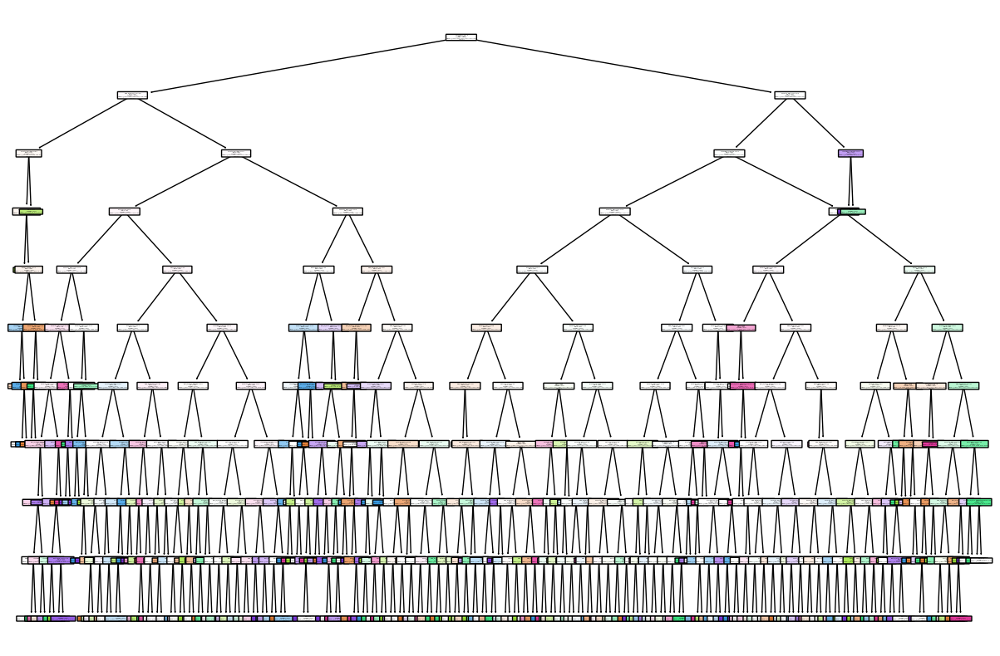


Most important features:
SAT_Score: 0.1499
High_School_GPA: 0.1436
University_GPA: 0.1216
University_Ranking: 0.1112
Projects_Completed: 0.0797
Age: 0.0762
Networking_Score: 0.0742
Soft_Skills_Score: 0.0541
Internships_Completed: 0.0527
Certifications: 0.0288
Field_of_Study_Mathematics: 0.0191
Field_of_Study_Medicine: 0.0144
Gender_Female: 0.0140
Entrepreneurship_Yes: 0.0132
Field_of_Study_Business: 0.0103
Field_of_Study_Computer Science: 0.0079
Entrepreneurship_No: 0.0076
Gender_Male: 0.0062
Field_of_Study_Engineering: 0.0050
Field_of_Study_Arts: 0.0042
Field_of_Study_Law: 0.0036
Gender_Other: 0.0025


In [36]:
cv_classifier_tree("Job_Offers")

Talk about results for our `Job_Offers` from above.

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ..max_depth=2, min_samples_split=5;, score=0.096 total time=   0.0s
[CV 2/5] END ..max_depth=2, min_samples_split=5;, score=0.101 total time=   0.0s
[CV 3/5] END ..max_depth=2, min_samples_split=5;, score=0.116 total time=   0.0s
[CV 4/5] END ..max_depth=2, min_samples_split=5;, score=0.096 total time=   0.0s
[CV 5/5] END ..max_depth=2, min_samples_split=5;, score=0.090 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=10;, score=0.096 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=10;, score=0.101 total time=   0.0s
[CV 3/5] END .max_depth=2, min_samples_split=10;, score=0.116 total time=   0.0s
[CV 4/5] END .max_depth=2, min_samples_split=10;, score=0.096 total time=   0.0s
[CV 5/5] END .max_depth=2, min_samples_split=10;, score=0.090 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=20;, score=0.096 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=20;

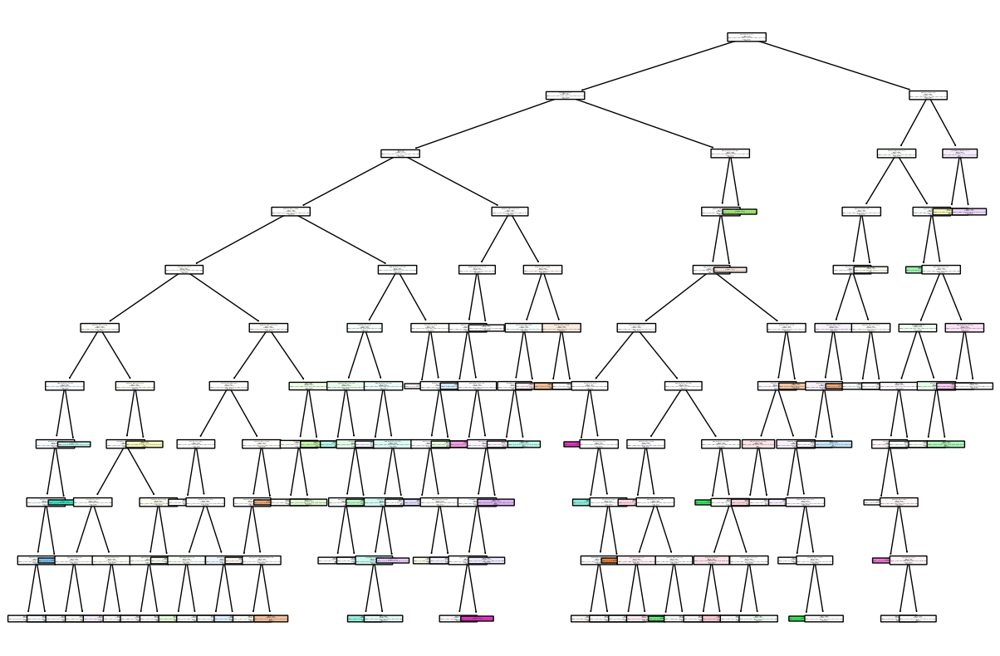


Most important features:
SAT_Score: 0.1853
University_GPA: 0.1853
High_School_GPA: 0.1577
University_Ranking: 0.1511
Soft_Skills_Score: 0.0745
Internships_Completed: 0.0606
Age: 0.0431
Networking_Score: 0.0377
Certifications: 0.0324
Projects_Completed: 0.0321
Field_of_Study_Law: 0.0206
Entrepreneurship_Yes: 0.0105
Field_of_Study_Computer Science: 0.0091
Gender_Female: 0.0000
Gender_Male: 0.0000
Gender_Other: 0.0000
Field_of_Study_Arts: 0.0000
Field_of_Study_Business: 0.0000
Field_of_Study_Engineering: 0.0000
Field_of_Study_Mathematics: 0.0000
Field_of_Study_Medicine: 0.0000
Entrepreneurship_No: 0.0000


In [37]:
cv_classifier_tree("Career_Satisfaction")

Talk about our results for `Career_Satisfaction` here:

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ..max_depth=2, min_samples_split=5;, score=0.187 total time=   0.0s
[CV 2/5] END ..max_depth=2, min_samples_split=5;, score=0.207 total time=   0.0s
[CV 3/5] END ..max_depth=2, min_samples_split=5;, score=0.220 total time=   0.0s
[CV 4/5] END ..max_depth=2, min_samples_split=5;, score=0.196 total time=   0.0s
[CV 5/5] END ..max_depth=2, min_samples_split=5;, score=0.221 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=10;, score=0.187 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=10;, score=0.207 total time=   0.0s
[CV 3/5] END .max_depth=2, min_samples_split=10;, score=0.220 total time=   0.0s
[CV 4/5] END .max_depth=2, min_samples_split=10;, score=0.196 total time=   0.0s
[CV 5/5] END .max_depth=2, min_samples_split=10;, score=0.221 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=20;, score=0.187 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=20;

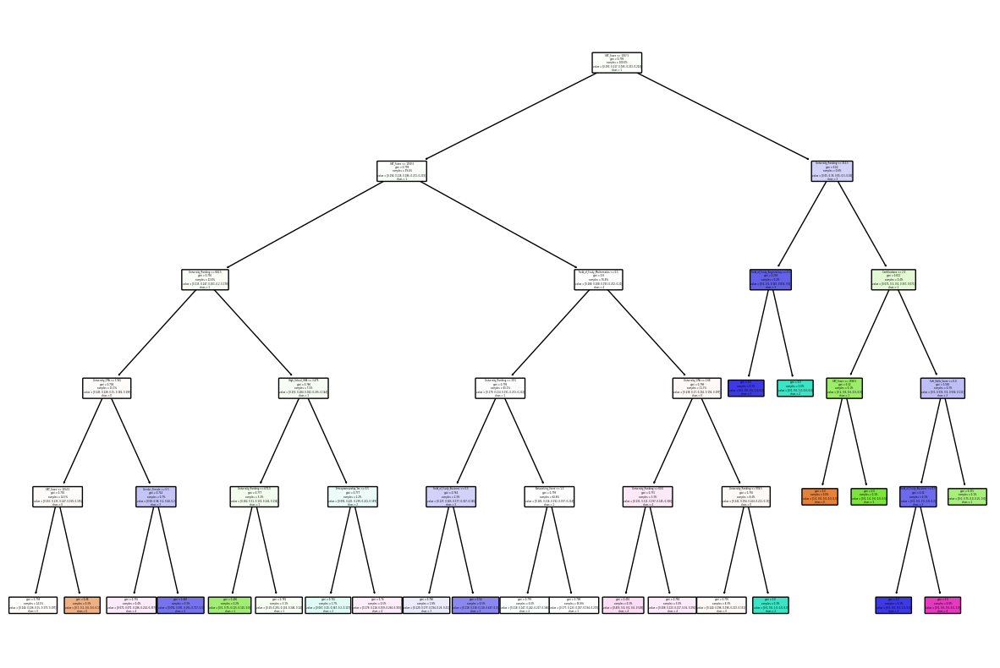


Most important features:
University_Ranking: 0.2766
SAT_Score: 0.1923
University_GPA: 0.1191
Field_of_Study_Business: 0.0751
Networking_Score: 0.0520
Gender_Female: 0.0495
Entrepreneurship_Yes: 0.0469
High_School_GPA: 0.0460
Field_of_Study_Mathematics: 0.0389
Soft_Skills_Score: 0.0376
Certifications: 0.0348
Field_of_Study_Engineering: 0.0312
Age: 0.0000
Internships_Completed: 0.0000
Projects_Completed: 0.0000
Gender_Male: 0.0000
Gender_Other: 0.0000
Field_of_Study_Arts: 0.0000
Field_of_Study_Computer Science: 0.0000
Field_of_Study_Law: 0.0000
Field_of_Study_Medicine: 0.0000
Entrepreneurship_No: 0.0000


In [38]:
cv_classifier_tree("Years_to_Promotion")

Write about our findings for `Years_to_Promotion` here:

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ..max_depth=2, min_samples_split=5;, score=0.100 total time=   0.0s
[CV 2/5] END ..max_depth=2, min_samples_split=5;, score=0.111 total time=   0.0s
[CV 3/5] END ..max_depth=2, min_samples_split=5;, score=0.103 total time=   0.0s
[CV 4/5] END ..max_depth=2, min_samples_split=5;, score=0.087 total time=   0.0s
[CV 5/5] END ..max_depth=2, min_samples_split=5;, score=0.106 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=10;, score=0.100 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=10;, score=0.111 total time=   0.0s
[CV 3/5] END .max_depth=2, min_samples_split=10;, score=0.103 total time=   0.0s
[CV 4/5] END .max_depth=2, min_samples_split=10;, score=0.087 total time=   0.0s
[CV 5/5] END .max_depth=2, min_samples_split=10;, score=0.106 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=20;, score=0.100 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=20;

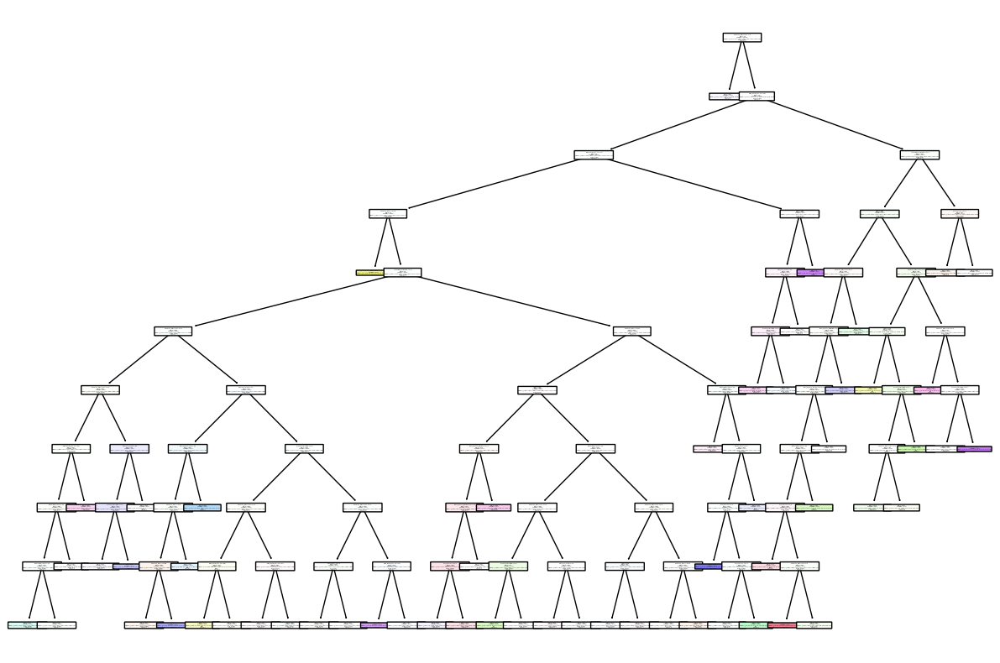


Most important features:
University_Ranking: 0.2105
High_School_GPA: 0.1079
Projects_Completed: 0.0997
Age: 0.0963
University_GPA: 0.0943
SAT_Score: 0.0830
Networking_Score: 0.0805
Soft_Skills_Score: 0.0687
Internships_Completed: 0.0337
Field_of_Study_Business: 0.0260
Field_of_Study_Mathematics: 0.0213
Gender_Other: 0.0171
Field_of_Study_Medicine: 0.0165
Certifications: 0.0160
Field_of_Study_Law: 0.0155
Field_of_Study_Engineering: 0.0129
Gender_Female: 0.0000
Gender_Male: 0.0000
Field_of_Study_Arts: 0.0000
Field_of_Study_Computer Science: 0.0000
Entrepreneurship_No: 0.0000
Entrepreneurship_Yes: 0.0000


In [39]:
cv_classifier_tree("Work_Life_Balance")

Talk about our results for `Work_Life_Balance` here:

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ..max_depth=2, min_samples_split=5;, score=0.476 total time=   0.0s
[CV 2/5] END ..max_depth=2, min_samples_split=5;, score=0.497 total time=   0.0s
[CV 3/5] END ..max_depth=2, min_samples_split=5;, score=0.511 total time=   0.0s
[CV 4/5] END ..max_depth=2, min_samples_split=5;, score=0.530 total time=   0.0s
[CV 5/5] END ..max_depth=2, min_samples_split=5;, score=0.490 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=10;, score=0.476 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=10;, score=0.497 total time=   0.0s
[CV 3/5] END .max_depth=2, min_samples_split=10;, score=0.511 total time=   0.0s
[CV 4/5] END .max_depth=2, min_samples_split=10;, score=0.530 total time=   0.0s
[CV 5/5] END .max_depth=2, min_samples_split=10;, score=0.490 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=20;, score=0.476 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=20;

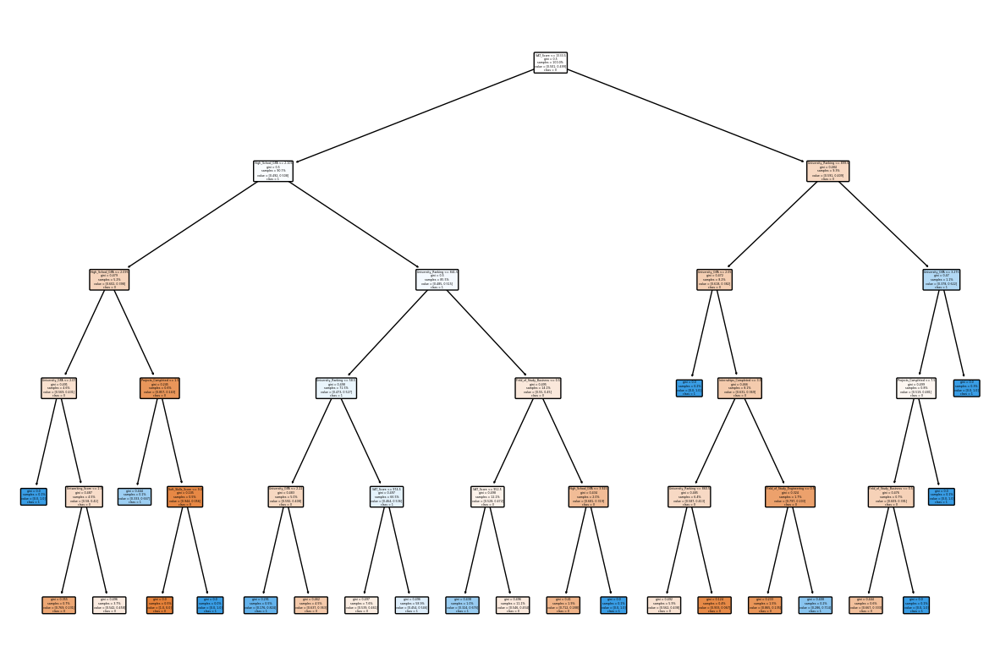


Most important features:
University_Ranking: 0.2255
University_GPA: 0.2160
SAT_Score: 0.1556
High_School_GPA: 0.1348
Projects_Completed: 0.0562
Field_of_Study_Business: 0.0556
Field_of_Study_Engineering: 0.0524
Internships_Completed: 0.0516
Networking_Score: 0.0283
Soft_Skills_Score: 0.0239
Age: 0.0000
Certifications: 0.0000
Gender_Female: 0.0000
Gender_Male: 0.0000
Gender_Other: 0.0000
Field_of_Study_Arts: 0.0000
Field_of_Study_Computer Science: 0.0000
Field_of_Study_Law: 0.0000
Field_of_Study_Mathematics: 0.0000
Field_of_Study_Medicine: 0.0000
Entrepreneurship_No: 0.0000
Entrepreneurship_Yes: 0.0000


In [40]:
cv_classifier_tree("Current_Job_Level_Entry")

Talk about results for `Current_Job_Level_Entry` here:

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ..max_depth=2, min_samples_split=5;, score=0.691 total time=   0.0s
[CV 2/5] END ..max_depth=2, min_samples_split=5;, score=0.699 total time=   0.0s
[CV 3/5] END ..max_depth=2, min_samples_split=5;, score=0.690 total time=   0.0s
[CV 4/5] END ..max_depth=2, min_samples_split=5;, score=0.699 total time=   0.0s
[CV 5/5] END ..max_depth=2, min_samples_split=5;, score=0.697 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=10;, score=0.691 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=10;, score=0.699 total time=   0.0s
[CV 3/5] END .max_depth=2, min_samples_split=10;, score=0.690 total time=   0.0s
[CV 4/5] END .max_depth=2, min_samples_split=10;, score=0.699 total time=   0.0s
[CV 5/5] END .max_depth=2, min_samples_split=10;, score=0.697 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=20;, score=0.691 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=20;

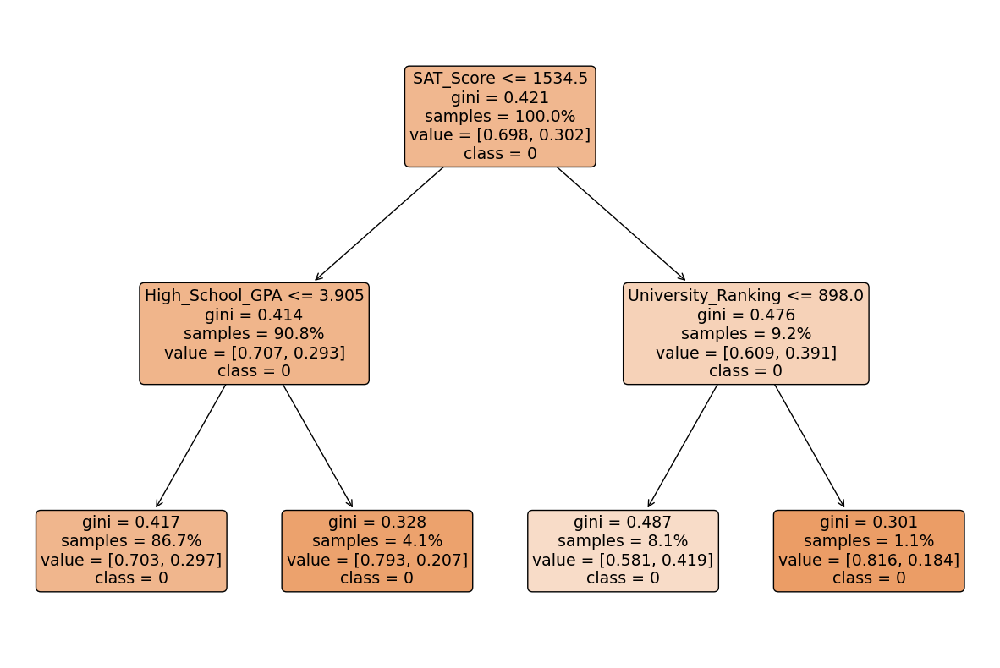


Most important features:
SAT_Score: 0.4898
University_Ranking: 0.3180
High_School_GPA: 0.1922
Age: 0.0000
University_GPA: 0.0000
Internships_Completed: 0.0000
Projects_Completed: 0.0000
Certifications: 0.0000
Soft_Skills_Score: 0.0000
Networking_Score: 0.0000
Gender_Female: 0.0000
Gender_Male: 0.0000
Gender_Other: 0.0000
Field_of_Study_Arts: 0.0000
Field_of_Study_Business: 0.0000
Field_of_Study_Computer Science: 0.0000
Field_of_Study_Engineering: 0.0000
Field_of_Study_Law: 0.0000
Field_of_Study_Mathematics: 0.0000
Field_of_Study_Medicine: 0.0000
Entrepreneurship_No: 0.0000
Entrepreneurship_Yes: 0.0000


In [41]:
cv_classifier_tree("Current_Job_Level_Mid")

Talk about results for `Current_Job_Level_Mid` here:

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ..max_depth=2, min_samples_split=5;, score=0.844 total time=   0.0s
[CV 2/5] END ..max_depth=2, min_samples_split=5;, score=0.844 total time=   0.0s
[CV 3/5] END ..max_depth=2, min_samples_split=5;, score=0.844 total time=   0.0s
[CV 4/5] END ..max_depth=2, min_samples_split=5;, score=0.840 total time=   0.0s
[CV 5/5] END ..max_depth=2, min_samples_split=5;, score=0.843 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=10;, score=0.844 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=10;, score=0.844 total time=   0.0s
[CV 3/5] END .max_depth=2, min_samples_split=10;, score=0.844 total time=   0.0s
[CV 4/5] END .max_depth=2, min_samples_split=10;, score=0.840 total time=   0.0s
[CV 5/5] END .max_depth=2, min_samples_split=10;, score=0.843 total time=   0.0s
[CV 1/5] END .max_depth=2, min_samples_split=20;, score=0.844 total time=   0.0s
[CV 2/5] END .max_depth=2, min_samples_split=20;

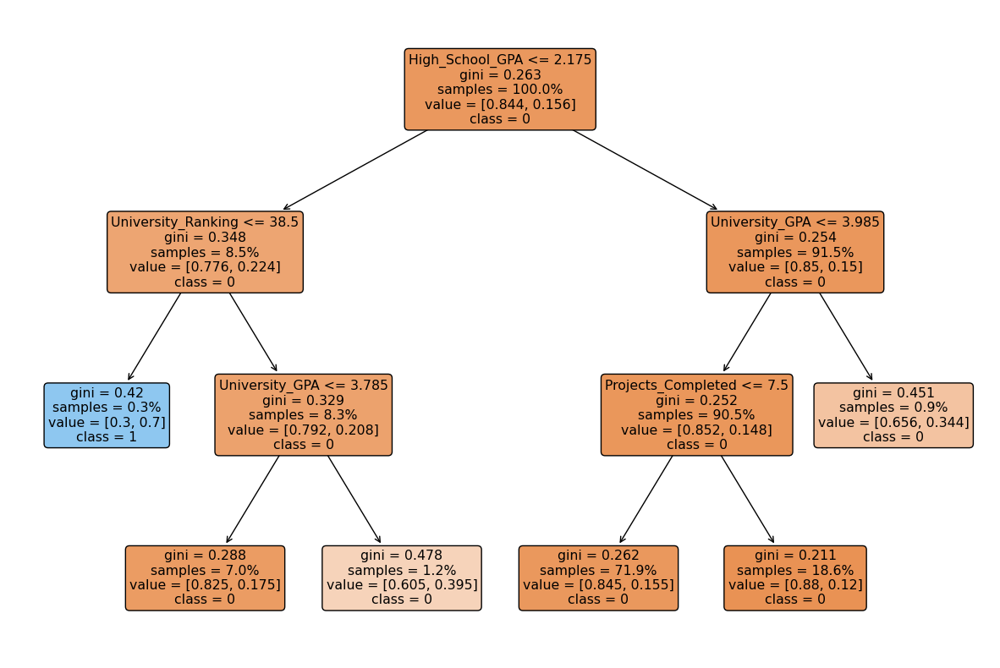


Most important features:
University_GPA: 0.4001
University_Ranking: 0.3127
High_School_GPA: 0.2022
Projects_Completed: 0.0849
Age: 0.0000
SAT_Score: 0.0000
Internships_Completed: 0.0000
Certifications: 0.0000
Soft_Skills_Score: 0.0000
Networking_Score: 0.0000
Gender_Female: 0.0000
Gender_Male: 0.0000
Gender_Other: 0.0000
Field_of_Study_Arts: 0.0000
Field_of_Study_Business: 0.0000
Field_of_Study_Computer Science: 0.0000
Field_of_Study_Engineering: 0.0000
Field_of_Study_Law: 0.0000
Field_of_Study_Mathematics: 0.0000
Field_of_Study_Medicine: 0.0000
Entrepreneurship_No: 0.0000
Entrepreneurship_Yes: 0.0000


In [42]:
cv_classifier_tree("Current_Job_Level_Senior")

Talk about results for `Current_Job_Level_Senior` here:

In [13]:
cv_classifier_tree("Current_Job_Level_Executive")

NameError: name 'cv_classifier_tree' is not defined

Comment on what we found from above with `Current_Job_Level_Executive`:

Transition to decisionTreeRegressor() on `Starting_Salary`

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END max_depth=2, min_samples_split=5;, score=-220948332.357 total time=   0.0s
[CV 2/5] END max_depth=2, min_samples_split=5;, score=-211250442.031 total time=   0.0s
[CV 3/5] END max_depth=2, min_samples_split=5;, score=-208862129.806 total time=   0.0s
[CV 4/5] END max_depth=2, min_samples_split=5;, score=-225353241.343 total time=   0.0s
[CV 5/5] END max_depth=2, min_samples_split=5;, score=-203764828.100 total time=   0.0s
[CV 1/5] END max_depth=2, min_samples_split=10;, score=-220948332.357 total time=   0.0s
[CV 2/5] END max_depth=2, min_samples_split=10;, score=-211250442.031 total time=   0.0s
[CV 3/5] END max_depth=2, min_samples_split=10;, score=-208862129.806 total time=   0.0s
[CV 4/5] END max_depth=2, min_samples_split=10;, score=-225353241.343 total time=   0.0s
[CV 5/5] END max_depth=2, min_samples_split=10;, score=-203764828.100 total time=   0.0s
[CV 1/5] END max_depth=2, min_samples_split=20;, score

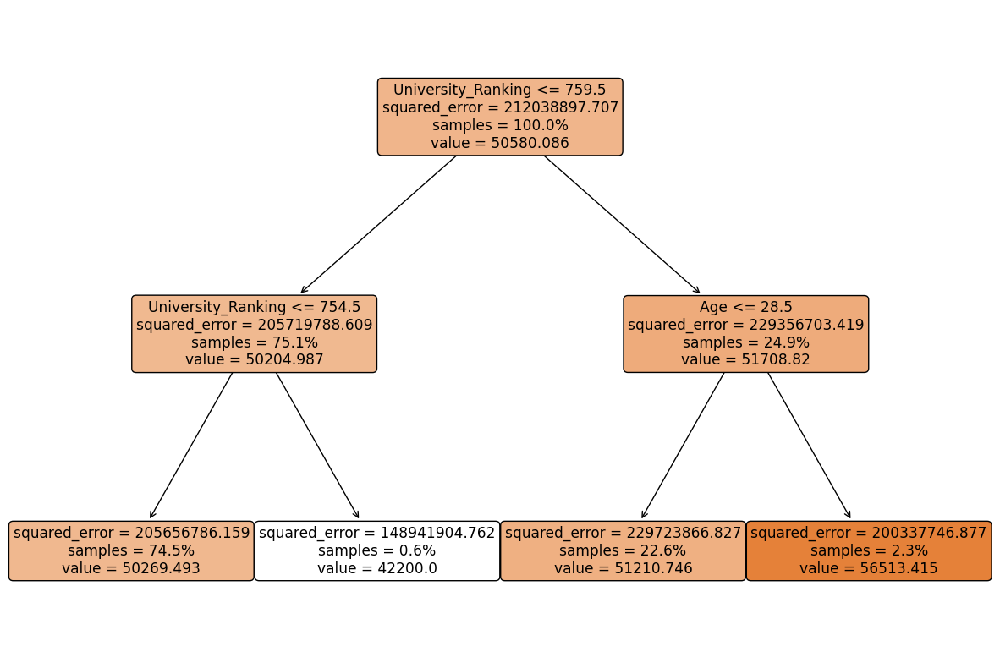


Most important features:
University_Ranking: 0.5760
Age: 0.4240
High_School_GPA: 0.0000
SAT_Score: 0.0000
University_GPA: 0.0000
Internships_Completed: 0.0000
Projects_Completed: 0.0000
Certifications: 0.0000
Soft_Skills_Score: 0.0000
Networking_Score: 0.0000
Gender_Female: 0.0000
Gender_Male: 0.0000
Gender_Other: 0.0000
Field_of_Study_Arts: 0.0000
Field_of_Study_Business: 0.0000
Field_of_Study_Computer Science: 0.0000
Field_of_Study_Engineering: 0.0000
Field_of_Study_Law: 0.0000
Field_of_Study_Mathematics: 0.0000
Field_of_Study_Medicine: 0.0000
Entrepreneurship_No: 0.0000
Entrepreneurship_Yes: 0.0000


In [17]:

career_cols = ["Job_Offers", "Work_Life_Balance", "Years_to_Promotion", "Career_Satisfaction", "Current_Job_Level_Entry", 
               "Current_Job_Level_Mid", "Current_Job_Level_Senior", "Current_Job_Level_Executive", "Starting_Salary"]

X = ml_data.drop(career_cols, axis=1)
y = ml_data["Starting_Salary"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

param_grid_dt = {
    "max_depth": [2, 3, 5, 10], 
    "min_samples_split": [5, 10, 20, 50]
}

search_dt = GridSearchCV(
    estimator=DecisionTreeRegressor(random_state=0),
    param_grid=param_grid_dt,
    scoring="neg_mean_squared_error",  # Change scoring metric for regression
    cv=5,
    verbose=3
)

search_dt.fit(X_train, y_train)

print("Best Decision Tree Parameters:", search_dt.best_params_)
best_tree = search_dt.best_estimator_

plt.figure(figsize=(15, 10))
plot_tree(best_tree, feature_names=X_train.columns, filled=True, rounded=True, proportion=True)  
plt.show()

importances = best_tree.feature_importances_
features_importance = list(zip(X_train.columns, importances))
features_importance.sort(key=lambda x: x[1], reverse=True)

print("\nMost important features:")
for feature, importance in features_importance:
    print(f"{feature}: {importance:.4f}")

In [12]:
print("Max Starting Salary:", ml_data["Starting_Salary"].max())
print("Min Starting Salary:", ml_data["Starting_Salary"].min())
print("Mean Starting Salary:", ml_data["Starting_Salary"].mean())

Max Starting Salary: 101000.0
Min Starting Salary: 25000.0
Mean Starting Salary: 50563.54


Comment on what we found from using `DecisionTreeRegressor` and compare its results to what we found using `LinearRegression` earlier.

## Conclusions on ML Stuff
HIHII

## Implications and Limitations

*Replace this text with your analysis. Who might benefit from your analysis and who might be excluded or otherwise harmed by it? What about the data setting might have impacted your results? Explain at least 3 limitations of your analysis and how others should or shouldn't be advised to use your conclusions. You may remove the code cell below if you don't need it.*

CONCLUSIONS AND STUFF